<a href="https://colab.research.google.com/github/nhwhite212/DealingwithDataSpring2021/blob/master/6-Pandas/F-Example_Citibike_Time_Series_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Example: Analyzing Citibike Station Activity using Pandas

In [ ]:
!sudo apt-get install -y python-dev libmysqlclient-dev && sudo pip install mysqlclient

Reading package lists... Done
Building dependency tree       
Reading state information... Done
python-dev is already the newest version (2.7.15~rc1-1).
libmysqlclient-dev is already the newest version (5.7.33-0ubuntu0.18.04.1).
libmysqlclient-dev set to manually installed.
0 upgraded, 0 newly installed, 0 to remove and 31 not upgraded.
     |████████████████████████████████| 92kB 4.7MB/s 
  Created wheel for mysqlclient: filename=mysqlclient-2.0.3-cp37-cp37m-linux_x86_64.whl size=100102 sha256=8f89dfaf7c324479ae4f8a06970d34b5a22c802681f70cd9d4c8c6f5e40d58b5
  Stored in directory: /root/.cache/pip/wheels/75/ca/e8/ad4e7ce3df18bcd91c7d84dd28c7c08db491a2a2360efed363
Successfully built mysqlclient


We are going to use the database of snapshots of Citibike stations statuses. 

In [ ]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
import pandas as pd
import matplotlib 
import matplotlib.pyplot as plt
matplotlib.style.use(['seaborn-talk', 'seaborn-ticks', 'seaborn-whitegrid'])

In [ ]:
! pip3 install -U sklearn geopandas

Requirement already up-to-date: sklearn in /usr/local/lib/python3.7/dist-packages (0.0)
Requirement already up-to-date: geopandas in /usr/local/lib/python3.7/dist-packages (0.9.0)


## Fetching Data

We will first fetch the data from the database. The original SQL query on the raw data is the following, and is computing the average capacity of a bike station in hourly intervals.

```sql
    SELECT S.station_id AS id, 
           AVG(num_bikes_available) AS available_bikes,
           AVG(num_docks_available) AS available_docks,
           AVG(num_bikes_disabled) AS disabled_bikes,
           AVG(num_docks_disabled) AS disabled_docks,
           T.capacity, T.lat, T.lon, T.name,
           DATE_FORMAT(last_reported, '%%Y-%%m-%%d %%H:00:00') AS communication_time 
    FROM citibike_new.Status S JOIN citibike_new.Stations T ON T.station_id = S.station_id
    WHERE  is_renting=1 AND is_installed=1 AND T.capacity>0 AND last_reported>='2017-10-01' AND last_reported<='2017-11-15'
    GROUP BY S.station_id, communication_time
```

For speed, we store the results of this query in a table.

In [ ]:
%%time
from sqlalchemy import create_engine

conn_string = 'mysql://{user}:{password}@{host}/{database}?charset={encoding}'.format(
    host = 'db.ipeirotis.org', 
    user = 'student',
    password = 'dwdstudent2015',
    database = 'citibike_fall2017',
    encoding = 'utf8mb4')
engine = create_engine(conn_string)

query = '''
SELECT *
FROM status_fall2017
'''
df = pd.read_sql(query, con=engine)
df.communication_time = pd.to_datetime(df.communication_time, format='%Y-%m-%d %H:%M:%S')


CPU times: user 3.63 s, sys: 450 ms, total: 4.08 s
Wall time: 7.13 s


In [ ]:
len(df)

541075

In [ ]:
df.head(5)

,id,available_bikes,available_docks,disabled_bikes,disabled_docks,capacity,lat,lon,name,communication_time
0,72,16.0000,22.0000,1.0,0.0,39,40.7673,-73.9939,W 52 St & 11 Ave,2017-10-01 00:00:00
1,72,16.7500,21.2500,1.0,0.0,39,40.7673,-73.9939,W 52 St & 11 Ave,2017-10-01 01:00:00
2,72,14.0000,24.0000,1.0,0.0,39,40.7673,-73.9939,W 52 St & 11 Ave,2017-10-01 02:00:00
3,72,15.5000,22.5000,1.0,0.0,39,40.7673,-73.9939,W 52 St & 11 Ave,2017-10-01 03:00:00
4,72,15.4286,22.5714,1.0,0.0,39,40.7673,-73.9939,W 52 St & 11 Ave,2017-10-01 05:00:00


### Exploratory Analysis

As a first step, let's see how the status of the bike stations evolves over time. We compute the average "**fullness**" of **all** the bike stations over time.

In [ ]:
df['percent_full'] = df.available_bikes / df.capacity

Now let's plot the activity over time. We can see that the percentage of bikes in the stations fluctuates over time, with around 10% difference from the daily-lows to the daily-highs. 

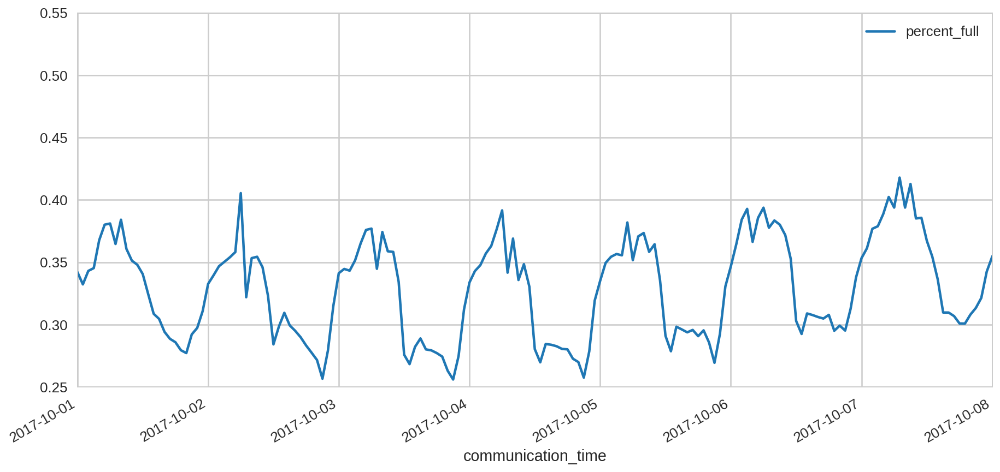

In [ ]:
timeseries = df.pivot_table(
    index='communication_time', 
    values='percent_full',
    aggfunc='mean'
)

timeseries.plot( figsize=(15, 7), ylim=(0.25,0.55), xlim=('2017-10-01', '2017-10-08'))

Let's do also the seasonal decomposition to see the result.

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


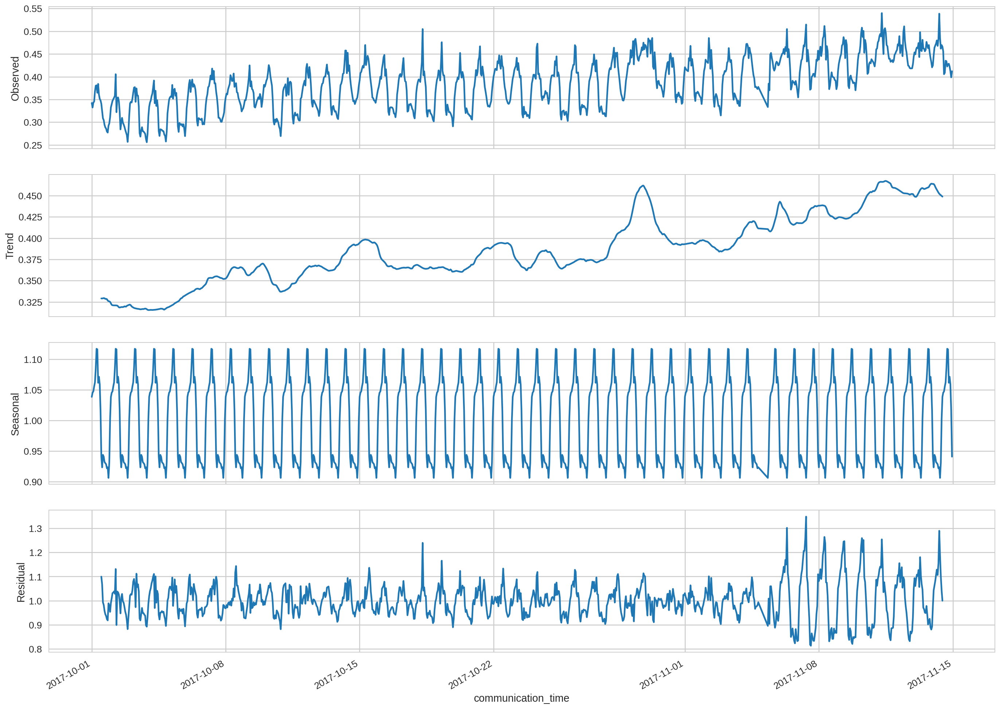

In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose

decomposition = seasonal_decompose(timeseries, model='multiplicative', freq=24)
seasonal = decomposition.plot()  
seasonal.set_size_inches(20, 15)

### Examining Time Series per Station

We now create a pivot table, to examine the time series for individual stations.

Notice that we use the `interpolate` method, where we fill the cells using interpolation using the non-missing values before and after.

In [ ]:
station_timeseries = df.pivot_table(
    index='communication_time', 
    columns='id', 
    values='percent_full', 
    aggfunc='mean'
).interpolate(method='time') 

station_timeseries.head(5)

id,72,79,82,83,116,119,120,127,128,143,144,146,150,151,152,153,157,161,164,167,168,173,174,195,212,216,217,223,228,229,232,236,237,238,239,241,242,243,244,245,...,3456,3458,3459,3461,3462,3463,3466,3467,3469,3472,3474,3476,3477,3478,3479,3480,3481,3486,3489,3490,3492,3493,3494,3495,3496,3497,3500,3501,3502,3503,3506,3509,3511,3535,3536,3542,3551,3552,3553,3632
communication_time,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2017-10-01 00:00:00,0.410256,0.072727,0.148148,0.508065,0.141026,0.500000,0.105263,0.458781,0.941667,0.020833,0.868421,0.166667,0.217742,0.162336,0.068966,NaN,0.295652,0.840000,0.054711,0.011111,0.831560,0.159314,0.363333,0.088889,0.221429,0.086957,0.179487,0.272727,0.072727,0.416148,0.391304,0.717949,0.606467,0.548387,0.048387,0.782609,0.673913,0.838710,0.290323,0.304348,...,NaN,0.100000,0.166668,0.242424,0.051282,0.273649,0.269609,0.640874,0.043478,0.256410,0.347222,0.376000,0.515152,0.674419,NaN,0.555556,0.045455,0.033333,0.241935,NaN,NaN,0.112903,0.260000,0.576923,0.36,0.347826,NaN,0.103448,NaN,NaN,NaN,NaN,0.136364,0.166667,0.046512,NaN,0.130435,NaN,0.108108,0.109091
2017-10-01 01:00:00,0.429487,0.060606,0.129630,0.493548,0.124541,0.505263,0.052632,0.322581,0.900000,0.020833,0.815789,0.112821,0.419355,0.121212,0.077586,NaN,0.425122,0.826666,0.021277,0.050000,0.742317,0.110294,0.366667,0.066667,0.178571,0.478261,0.241759,0.264070,0.078787,0.373913,0.391304,0.824456,0.851851,0.652329,0.048387,0.771739,0.608696,0.814516,0.258065,0.326087,...,0.318182,0.062500,0.205882,0.196970,0.015385,0.253070,0.215685,0.717262,0.036232,0.264957,0.250000,0.253332,0.515152,0.651163,NaN,0.611111,0.056818,0.000000,0.209677,0.112903,NaN,0.096774,0.320000,0.586538,0.40,0.347826,NaN,0.103448,0.172414,0.066667,NaN,0.064516,0.181818,0.164815,0.007751,NaN,0.130435,0.025641,0.144143,0.151515
2017-10-01 02:00:00,0.358974,0.030303,0.185185,0.467742,0.051282,0.510526,0.026316,0.304658,0.944443,0.020833,0.815789,0.076923,0.370968,0.084848,0.022990,NaN,0.269565,0.801360,0.044917,0.088889,0.648936,0.062745,0.413333,0.044444,0.132654,0.717391,0.247864,0.141415,0.090909,0.413043,0.391304,0.556562,0.884615,0.693548,0.112903,0.760870,0.630435,0.838710,0.225806,0.347826,...,0.303030,0.050000,0.205882,0.212121,0.011965,0.194595,0.151962,0.773810,0.028986,0.273504,0.208333,0.333332,0.515152,0.643412,NaN,0.592593,0.068182,0.008333,0.161290,0.108871,NaN,0.096774,0.380000,0.596154,0.48,0.347826,0.032258,0.103448,0.163793,0.066667,0.034483,0.088710,0.136364,0.162963,0.012919,0.017241,0.152174,0.000000,0.243243,0.115152
2017-10-01 03:00:00,0.397436,0.025974,0.240741,0.493952,0.108974,0.515789,0.000000,0.361290,0.876190,0.031250,0.835526,0.025641,0.491039,0.136364,0.068966,NaN,0.418478,0.795606,0.031915,0.122222,0.577509,0.037582,0.400000,0.029629,0.165179,0.714286,0.256410,0.130303,0.086364,0.358696,0.391304,0.608974,0.791667,0.677419,0.172042,0.717391,0.652174,0.822581,0.225806,0.326087,...,0.287879,0.035715,0.205882,0.196970,0.008546,0.180181,0.117647,0.801588,0.021739,0.282051,0.236111,0.544000,0.515152,0.697674,NaN,0.574074,0.079545,0.016667,0.193548,0.104839,NaN,0.096774,0.306668,0.605769,0.50,0.347826,0.035484,0.103448,0.155172,0.066667,0.034483,0.112903,0.181818,0.161111,0.018088,0.034483,0.173913,0.000000,0.279278,0.260606
2017-10-01 04:00:00,0.396521,0.021645,0.259259,0.489247,0.256410,0.521053,0.052632,0.380645,0.804167,0.041667,0.855263,0.008546,0.607526,0.060606,0.068966,NaN,0.304348,0.739286,0.031915,0.166667,0.536170,0.078431,0.450000,0.022222,0.044643,0.711180,0.282051,0.072727,0.027273,0.417391,0.391304,0.520513,0.833333,0.677419,0.193548,0.782609,0.673913,0.806452,0.290323,0.304348,...,0.272727,0.058332,0.186274,0.212121,0.014244,0.216216,0.058824,0.761905,0.028986,0.299146,0.229167,0.640000,0.515152,0.702326,NaN,0.555556,0.090909,0.025000,0.177419,0.100806,NaN,0.096774,0.260000,0.615385,0.52,0.347826,0.038710,0.103448,0.146552,0.066667,0.034483,0.161290,0.190909,0.159259,0.023256,0.045978,0.195652

Let's plot the time series for *all* bike stations, for a few days.

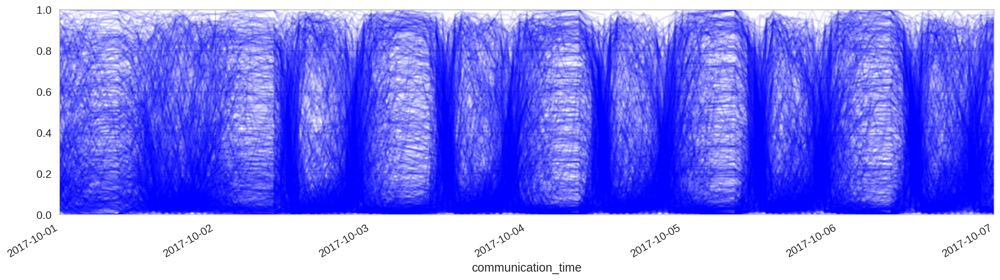

In [ ]:
station_timeseries.plot(
    alpha=0.1, 
    color='b', 
    legend=False, 
    figsize=(20,5), 
    xlim=('2017-10-01','2017-10-07'),
    ylim=(0,1)
)

Let's limit our plot to just two stations:
* Station 3260 at "Mercer St & Bleecker St"
* Station 161 at "LaGuardia Pl & W 3 St"

which are nearby and tend to exhibit similar behavior. Remember that the list of stations is [available as a JSON](https://feeds.citibikenyc.com/stations/stations.json) 

In [ ]:
# df [ df.name.str.contains("Mercer") & df.name.str.contains("Bleecker") ]
# df [ df.name.str.contains("LaGuardia") ]

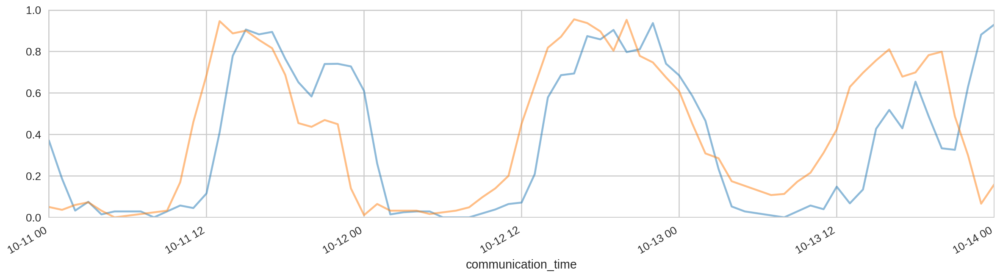

In [ ]:
station_timeseries[ [161, 3260] ].plot(
    alpha=0.5,  
    legend=False, 
    figsize=(20,5), 
    xlim=('2017-10-11','2017-10-14'),
    ylim=(0,1)
)

## Finding Bike Stations with Similar Behavior

For our next analysis, we are going to try to find bike stations that have similar behaviors over time. A very simple technique that we can use to find similar time series is to treat the time series as vectors, and compute their correlation. Pandas provides the `corr` function that can be used to calculate the correlation of columns. (If we want to compute the correlation of rows, we can just take the transpose of the dataframe using the `transpose()` function, and compute the correlations there.)

In [ ]:
similarities = station_timeseries.corr(method='pearson')
similarities.head(5)

id,72,79,82,83,116,119,120,127,128,143,144,146,150,151,152,153,157,161,164,167,168,173,174,195,212,216,217,223,228,229,232,236,237,238,239,241,242,243,244,245,...,3456,3458,3459,3461,3462,3463,3466,3467,3469,3472,3474,3476,3477,3478,3479,3480,3481,3486,3489,3490,3492,3493,3494,3495,3496,3497,3500,3501,3502,3503,3506,3509,3511,3535,3536,3542,3551,3552,3553,3632
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
72,1.000000,-0.347045,0.232946,-0.167227,0.093290,0.171986,0.297095,0.233466,-0.235597,-0.140796,-0.085704,-0.227088,0.431160,-0.129564,-0.255984,NaN,0.212069,-0.264447,-0.322857,-0.233263,-0.331590,-0.267079,0.478310,-0.384960,-0.321109,0.096542,-0.248763,0.393266,-0.360910,-0.146175,0.015625,0.430183,0.400811,0.255445,-0.316095,0.229424,-0.106289,-0.197860,0.312976,0.032637,...,-0.006470,-0.305340,-0.334423,-0.278814,-0.232143,0.058345,-0.275990,-0.319308,-0.317226,-0.409250,-0.251033,0.131539,-0.044506,-0.247373,-0.189473,0.002781,0.012416,-0.021140,-0.243460,0.118297,0.086904,0.247696,0.117415,0.002688,0.256827,0.023255,0.194941,0.270409,0.153167,0.176304,0.063324,0.294699,0.211622,0.119909,-0.108542,-0.180642,0.291919,0.156979,0.373690,0.330081
79,-0.347045,1.000000,0.097550,0.453438,0.311674,-0.138293,-0.456938,-0.235306,0.350069,0.398496,-0.074929,0.614132,-0.595000,0.602098,0.708182,NaN,-0.214900,0.434944,0.314300,0.550987,0.525426,0.588739,-0.414717,0.635598,0.594163,-0.059944,0.297797,-0.235730,0.519420,0.461946,0.310601,-0.620888,-0.618915,-0.448772,0.586302,-0.419632,0.336811,0.224987,-0.391864,-0.295526,...,-0.273068,0.586722,0.640246,0.580847,0.602685,0.292258,0.528062,0.584997,0.534925,0.638202,0.524934,-0.572571,0.088466,0.364652,0.152429,0.144390,-0.108793,-0.034234,0.688653,-0.336300,-0.036305,-0.411045,-0.140630,0.036652,-0.410683,-0.062490,-0.319338,-0.164962,0.022296,-0.212676,0.165300,0.262670,-0.134893,-0.201125,0.367742,0.355370,-0.312069,0.022535,-0.277437,-0.473167
82,0.232946,0.097550,1.000000,0.074904,0.104074,0.067588,0.087829,0.335759,0.059021,-0.074860,-0.240088,0.259343,0.097425,0.113874,0.078849,NaN,0.083179,0.037949,-0.095595,0.060445,-0.126221,0.028915,0.177790,0.040232,0.039939,-0.103667,0.066906,0.362951,-0.038132,0.049560,-0.010327,0.151181,0.125798,0.140314,0.007285,-0.076934,-0.061960,-0.120445,0.009630,-0.087198,...,-0.523983,-0.015691,-0.075688,0.042869,0.053120,0.157352,0.008017,-0.044525,-0.161357,-0.053512,-0.101482,-0.394355,-0.134324,0.029728,-0.039293,0.202486,-0.087859,0.204971,0.105762,-0.034065,-0.214451,-0.031172,0.015579,0.382173,0.182171,0.002951,0.243566,-0.019731,0.218533,0.236151,0.162258,0.227383,0.272078,0.135422,0.207336,0.196475,-0.016738,0.209621,0.251452,0.136888
83,-0.167227,0.453438,0.074904,1.000000,0.277944,-0.192117,-0.413392,-0.172348,0.401813,0.278734,-0.071480,0.272125,-0.463824,0.457728,0.259649,NaN,-0.216284,0.520212,0.076771,0.407933,0.424557,0.264283,-0.424496,0.439771,0.419346,0.200462,0.291884,-0.101756,0.304281,0.422606,0.129772,-0.360600,-0.310553,-0.262576,0.325198,-0.310497,0.139179,0.200823,-0.427674,-0.245193,...,-0.258794,0.309411,0.352949,0.438759,0.460553,0.208249,0.328773,0.477169,0.259129,0.468601,0.436977,-0.410372,0.174420,0.244029,0.044622,-0.036111,-0.137678,-0.022976,0.324378,-0.090804,0.140570,-0.212522,-0.001077,0.040039,-0.370000,0.031366,-0.199275,0.071380,0.170512,0.101991,0.081840,0.234099,0.131422,-0.110038,0.326383,0.315282,-0.287316,0.043190,-0.231002,-0.403371
116,0.093290,0.311674,0.104074,0.277944,1.000000,0.207111,-0.249466,-0.046407,0.011315,0.236189,0.011209,0.152993,-0.166949,0.301711,0.206263,NaN,-0.049382,0.217414,-0.037565,0.261514,0.202889,0.294226,-0.120918,0.237516,0.245502,0.118825,0.261124,0.161802,0.130484,0.180303,0.212257,-0.195931,-0.264444,-0.094913,0.228891,-0.096044,0.062416,0.005048,-0.006420,-0.204006,...,0.029159,0.127158,0.327935,0.315424,0.408877,0.484362,0.231141,0.348221,0.089444,0.292107,0.290590,-0.370189,-0.090520,-0.037104,-0.276876,0.112566,0.117738,-0.03

Let's see the similarities of the two stations that we examined above.

In [ ]:
stations = [161, 3260]

similarities[stations].loc[stations]

id,161,3260
id,,
161,1.000000,0.692026
3260,0.692026,1.000000


In [ ]:
# 393: E 5 St & Avenue C
# 2003: 1 Ave & E 18 St
stations = [393, 2003] 
    
similarities[stations].loc[stations]

id,393,2003
id,,
393,1.000000,0.891826
2003,0.891826,1.000000


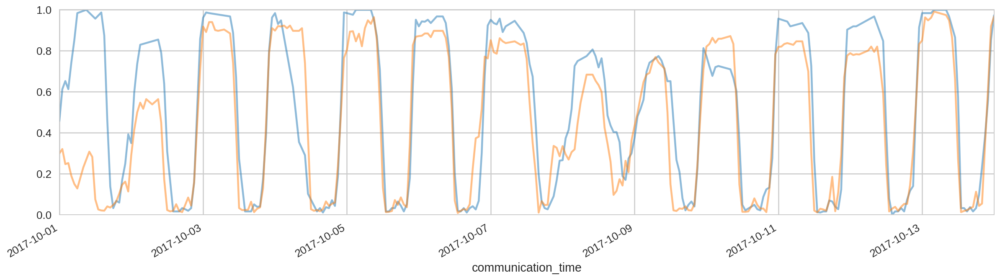

In [ ]:
station_timeseries[ [393, 2003]  ].plot(
    alpha=0.5,  
    legend=False, 
    figsize=(20,5), 
    xlim=('2017-10-01','2017-10-14'),
    ylim=(0,1)
)

For bookkeeping purposes, we are going to drop stations that generate NaN values, as we cannot use such entries for our analysis.

In [ ]:
# Number of stations with non-NaN similarity per station
check = similarities.count()
# Find the number of stations with less than the max number of similarities
todrop = check[check < check.max()].index.values
similarities.drop(todrop, axis='index', inplace=True)
similarities.drop(todrop, axis='columns', inplace=True)

### Clustering Based on Distances

Without explaining too much about clustering, we are going to use a clustering technique and cluster together bike stations that are "nearby" according to our similarity analysis. For this, we need to first convert our similarities to distance.

We are now going to convert our **similarities** into **distance** metrics. Our distance values will be always positive, and bounded between 0 and 1.

* If two stations have correlation 1, they behave identically, and therefore have distance 0, 
* If two stations have correlation -1, they have exactly the oppositite behaviors, and therefore we want to have distance 1 (the max) 

In [ ]:
# Similarity goes from -1 to 1, so 1-similarity goes from 0 to 2.
# So, we multiply with 0.5 to get it between 0 and 1, and then take the square
distances = ((.5*(1-similarities))**2)
distances.head(5)

id,72,79,82,83,116,119,120,127,128,143,144,146,150,151,152,157,161,164,167,168,173,174,195,212,216,217,223,228,229,232,236,237,238,239,241,242,243,244,245,248,...,3456,3458,3459,3461,3462,3463,3466,3467,3469,3472,3474,3476,3477,3478,3479,3480,3481,3486,3489,3490,3492,3493,3494,3495,3496,3497,3500,3501,3502,3503,3506,3509,3511,3535,3536,3542,3551,3552,3553,3632
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
72,0.000000,0.453633,0.147093,0.340605,0.205531,0.171402,0.123519,0.146894,0.381675,0.325354,0.294688,0.376436,0.080895,0.318979,0.394374,0.155209,0.399707,0.437487,0.380234,0.443283,0.401372,0.068040,0.479529,0.436332,0.204059,0.389853,0.092032,0.463019,0.328429,0.242248,0.081173,0.089757,0.138590,0.433027,0.148447,0.305969,0.358717,0.118000,0.233948,0.449635,...,0.253246,0.425978,0.445171,0.408841,0.379544,0.221678,0.407037,0.435143,0.433771,0.496496,0.391271,0.188556,0.272748,0.388985,0.353711,0.248612,0.243831,0.260682,0.386548,0.194350,0.208436,0.141490,0.194739,0.248658,0.138076,0.238508,0.162030,0.133076,0.179282,0.169619,0.219340,0.124362,0.155385,0.193640,0.307216,0.348479,0.125345,0.177671,0.098066,0.112198
79,0.453633,0.000000,0.203604,0.074683,0.118448,0.323928,0.530667,0.381495,0.105603,0.090452,0.288868,0.037224,0.636006,0.039581,0.021289,0.368995,0.079822,0.117546,0.050403,0.056305,0.042284,0.500356,0.033197,0.041176,0.280870,0.123272,0.381757,0.057739,0.072376,0.118818,0.656820,0.655221,0.524735,0.042786,0.503839,0.109955,0.150161,0.484321,0.419597,0.018152,...,0.405176,0.042700,0.032356,0.043922,0.039465,0.125225,0.055681,0.043057,0.054074,0.032724,0.056422,0.618245,0.207724,0.100917,0.179594,0.183017,0.307355,0.267410,0.024234,0.446425,0.268482,0.497762,0.325259,0.232010,0.497507,0.282221,0.435163,0.339284,0.238976,0.367646,0.174181,0.135914,0.321995,0.360676,0.099938,0.103887,0.430381,0.238859,0.407961,0.542555
82,0.147093,0.203604,0.000000,0.213951,0.200671,0.217348,0.208014,0.110304,0.221360,0.288831,0.384455,0.137143,0.203660,0.196305,0.212130,0.210140,0.231386,0.300082,0.220691,0.317093,0.235752,0.169007,0.230289,0.230429,0.304520,0.217666,0.101458,0.269429,0.225834,0.255190,0.180123,0.191057,0.184765,0.246371,0.289947,0.281940,0.313849,0.245208,0.295500,0.258820,...,0.580631,0.257907,0.289276,0.229025,0.224146,0.177514,0.246008,0.272758,0.337188,0.277472,0.303316,0.486057,0.321673,0.235357,0.270033,0.159007,0.295860,0.158018,0.199915,0.267323,0.368723,0.265829,0.242271,0.095428,0.167211,0.248527,0.143048,0.259963,0.152673,0.145866,0.175453,0.149234,0.132468,0.186874,0.157079,0.161413,0.258439,0.156175,0.140081,0.186241
83,0.340605,0.074683,0.213951,0.000000,0.130341,0.355286,0.499419,0.343600,0.089457,0.130056,0.287017,0.132451,0.535695,0.073515,0.137030,0.369837,0.057549,0.213088,0.087636,0.082784,0.135320,0.507297,0.078464,0.084290,0.159815,0.125357,0.303467,0.121006,0.083346,0.189324,0.462808,0.429387,0.398524,0.113840,0.429350,0.185253,0.159671,0.509563,0.387626,0.089779,...,0.396141,0.119228,0.104669,0.078748,0.072751,0.156717,0.112636,0.068338,0.137222,0.070596,0.079249,0.497287,0.170396,0.142873,0.228187,0.268381,0.323578,0.261620,0.114116,0.297463,0.184655,0.367552,0.250539,0.230381,0.469225,0.234563,0.359565,0.215584,0.172013,0.201605,0.210754,0.146651,0.188607,0.308046,0.113440,0.117210,0.414295,0.228872,0.378842,0.492363
116,0.205531,0.118448,0.200671,0.130341,0.000000,0.157168,0.390291,0.273742,0.244374,0.145852,0.244427,0.179355,0.340442,0.121902,0.157505,0.275301,0.153110,0.269135,0.136340,0.158847,0.124529,0.314114,0.145345,0.142317,0.194117,0.136484,0.175644,0.189014,0.167976,0.155135,0.357563,0.399704,0.299709,0.148652,0.300328,0.219766,0.247482,0.253221,0.362408,0.118050,...,0.235633,0.190463,0.112918,0.117161,0.087356,0.066471,0.147786,0.106204,0.207278,0.125278,0.125816,0.469354,0.297308,0.268896,0.407603,0.196885,0.194597,0.269208,0.066722,0.346265,0.191380,0.398025,0.272954,0.347298,0.381681,0.300834,0.255960,0.265208,0.150092,0.321877,0.29563

The clustering code is very simple: The code below will create two groups of stations.

In [ ]:
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import KMeans

cluster = KMeans(n_clusters=2)
cluster.fit(distances.values)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=2, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=None, tol=0.0001, verbose=0)

We will now take the results of the clustering and associate each of the data points into a cluster.

In [ ]:
labels = pd.DataFrame(list(zip(distances.index.values.tolist(), cluster.labels_)), columns = ["id", "cluster"])
labels.head(10)

,id,cluster
0,72,0
1,79,1
2,82,0
3,83,1
4,116,1
5,119,0
6,120,0
7,127,0
8,128,1
9,143,1


Let's see how many stations in each cluster

In [ ]:
labels.pivot_table(
    index = 'cluster',
    aggfunc = 'count'
)

,id
cluster,
0,420
1,253


### Visualizing the Time Series Clusters

We will start by assining a color to each cluster, so that we can plot each station-timeline with the cluster color. (We put a long list of colors, so that we can play with the number of clusters in the earlier code, and still get nicely colored results.)

In [ ]:
colors = list(['red','blue', 'green', 'magenta', 'yellow', 'black', 'white', 'cyan'])
labels['color'] = labels['cluster'].apply(lambda cluster_id : colors[cluster_id]) 
labels.head(10)

,id,cluster,color
0,72,0,red
1,79,1,blue
2,82,0,red
3,83,1,blue
4,116,1,blue
5,119,0,red
6,120,0,red
7,127,0,red
8,128,1,blue
9,143,1,blue


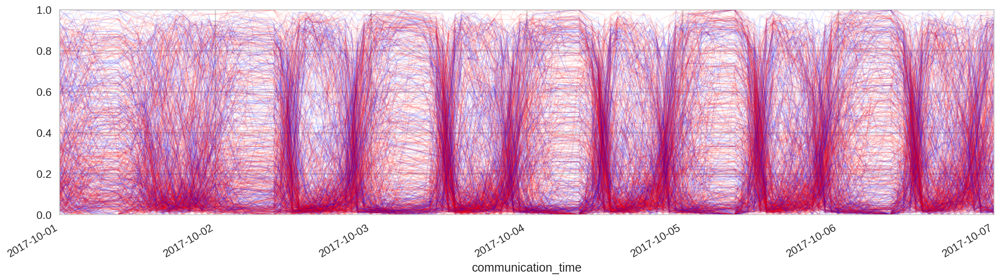

In [ ]:
stations_plot = station_timeseries.plot(
    alpha=0.1, 
    legend=False, 
    figsize=(20,5), 
    linewidth=1,
    color=labels["color"],
    xlim=('2017-10-01','2017-10-07'),
    ylim=(0,1)
)

The plot still looks messy. Let's try to plot instead a single line for each cluster. To represent the cluster, we are going to use the _median_ fullness value across all stations that belong to a cluster, for each timestamp. For that, we can again use a pivot table: we define the `communication_time` as one dimension of the table, and `cluster` as the other dimension, and we use the `median` function. 

For that, we first _join_ our original dataframe with the results of the clustering, using the `merge` command, and add an extra column that includes the clusterid for each station. Then we compute the pivot table.

In [ ]:
median_cluster = df.merge(
    labels, 
    how='inner', 
    on='id'
).pivot_table(
    index='communication_time', 
    columns='cluster', 
    values='percent_full', 
    aggfunc='median'
)

median_cluster.head(15)

cluster,0,1
communication_time,,
2017-10-01 00:00:00,0.290323,0.198718
2017-10-01 01:00:00,0.308641,0.188171
2017-10-01 02:00:00,0.347826,0.191918
2017-10-01 03:00:00,0.338755,0.168892
2017-10-01 04:00:00,0.381680,0.189911
2017-10-01 05:00:00,0.415230,0.217391
2017-10-01 06:00:00,0.427069,0.212121
2017-10-01 07:00:00,0.418860,0.191973
2017-10-01 08:00:00,0.425000,0.168880


Now, we can plot the medians for the two clusters.

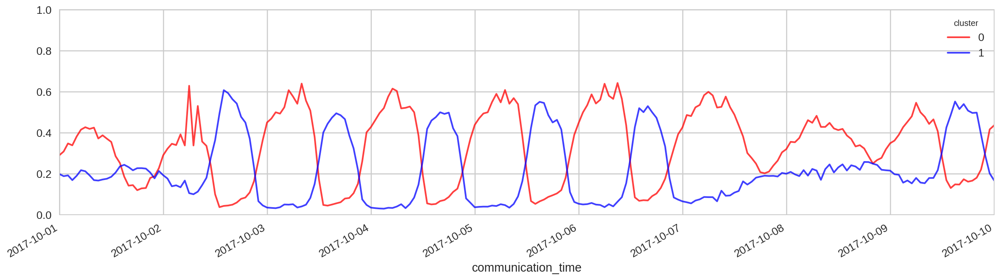

In [ ]:
median_cluster.plot(
    figsize=(20,5), 
    linewidth = 2, 
    alpha = 0.75,
    color=colors,
    ylim = (0,1),
    xlim=('2017-10-01','2017-10-10'),
    grid = True
)

And just for fun and for visual decoration, let's put the two plots together. We are going to fade a lot the individual station time series (by putting the `alpha=0.005`) and we are going to make more prominent the median lines by increasing their linewidths. We will limit our plot to one week's worth of data:

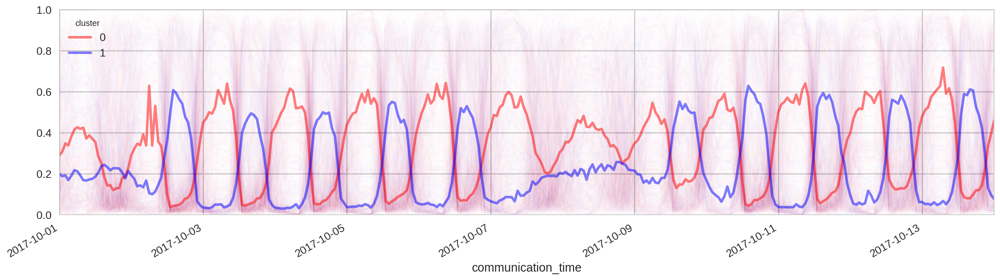

In [ ]:
stations_plot = station_timeseries.plot(
    alpha=0.005, 
    legend=False, 
    figsize=(20,5), 
    color=labels["color"]
)

median_cluster.plot(
    figsize=(20,5), 
    linewidth = 3, 
    alpha = 0.5,
    color=colors, 
    xlim=('2017-10-01','2017-10-14'),
    ylim=(0,1),
    ax = stations_plot
)

### Mapping

Now, we will plot the stations in a map, to see where the clusters are located.

Just to make things more interesting, we will also get information about the current status of the stations.

In [ ]:
# Get information about current (real-time) status of the stations 
import requests

url_status = 'https://gbfs.citibikenyc.com/gbfs/en/station_status.json'
results = requests.get(url_status).json() 
status = results["data"]["stations"]
df_status = pd.DataFrame(status)
df_status = df_status[ ['station_id', 'num_bikes_available'] ] #keep only station id and bikes available
df_status.columns = ['id', 'bikes_available'] # rename the columns
df_status.id = pd.to_numeric(df_status.id) # convert id to numeric
df_status.head(5)

,id,bikes_available
0,72,31
1,79,32
2,82,21
3,83,57
4,116,38


In [ ]:
df_status.dtypes

id                 int64
bikes_available    int64
dtype: object

In [ ]:
# Keep only the necessary columns / rows
map_df = df[ ['id', 'lon', 'lat', 'capacity'] ].drop_duplicates()
# Join the list of stations with the cluster
map_df = map_df.merge(
    labels, 
    how='inner', 
    on='id'
)
# Join the list of stations with the current status
map_df = map_df.merge(
    df_status, 
    how='inner', 
    on='id'
)
map_df = map_df.set_index('id')
# Reorder the columns
map_df = map_df[ ['cluster', 'capacity', 'color', 'lon', 'lat', 'bikes_available'] ] 

In [ ]:
map_df.head(5)

,cluster,capacity,color,lon,lat,bikes_available
id,,,,,,
72,0,39,red,-73.9939,40.7673,31
79,1,33,blue,-74.0067,40.7191,32
82,0,27,red,-74.0002,40.7112,21
83,1,62,blue,-73.9763,40.6838,57
116,1,39,blue,-74.0015,40.7418,38


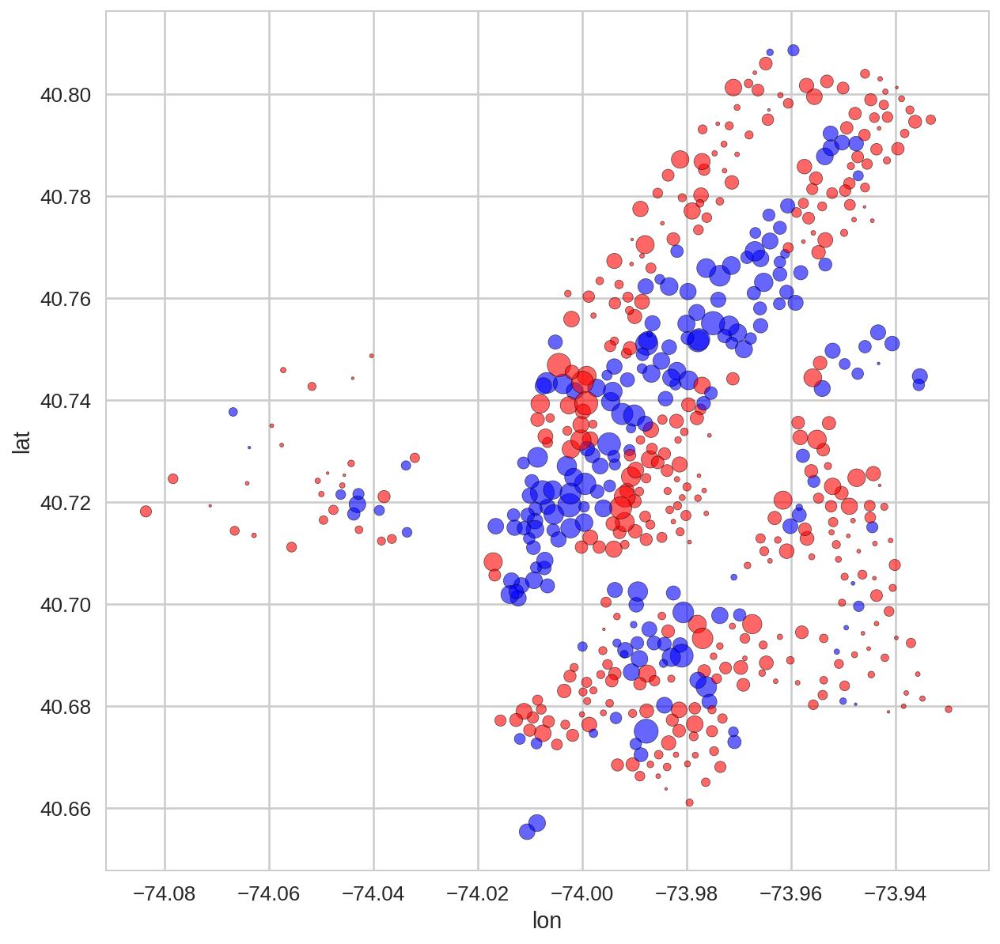

In [ ]:
# Plot the stations using a scatterplot with their lon/lat values
# Use a different color for each cluster
# Change the size of each dot according to the capacity
map_df.plot.scatter(
    x = 'lon',
    y = 'lat',
    edgecolors='Black',
    c = map_df.color.values,
    s = 3*map_df.bikes_available.values,
    figsize=(10,10), alpha=0.6
)


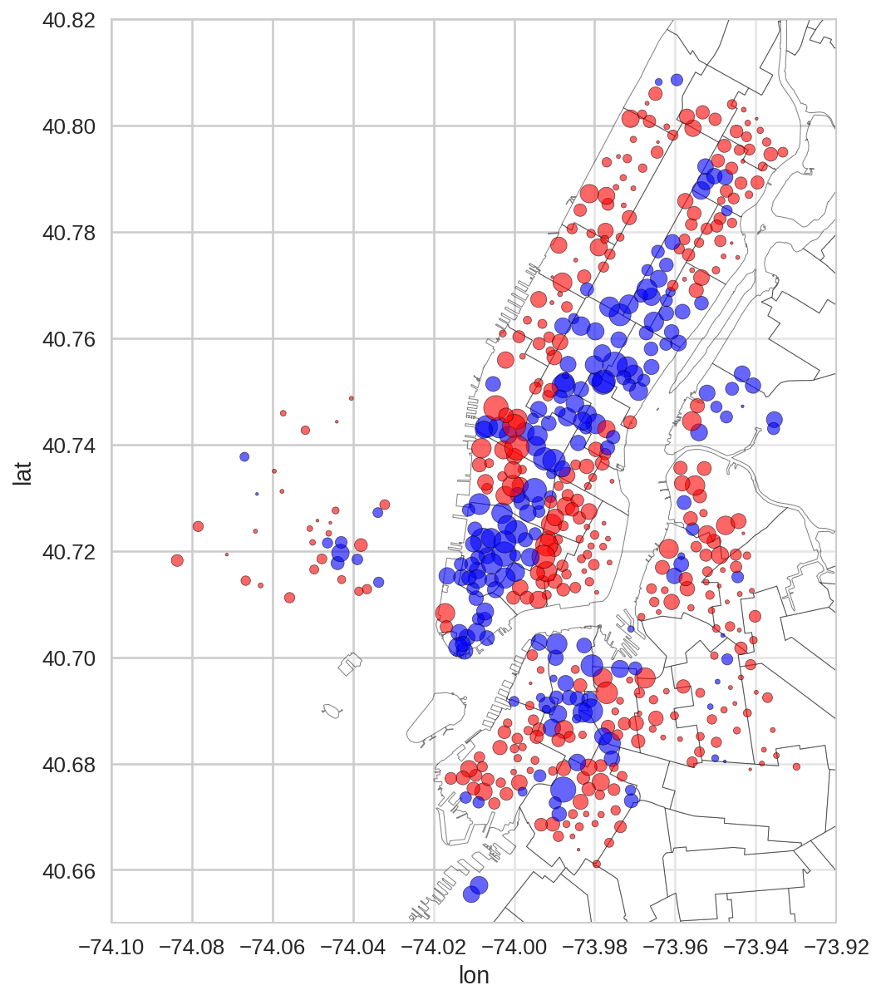

In [ ]:
# We draw a background with the map of the NYC neighborhoods
import geopandas as gpd

# Dataset from NYC Open Data: https://data.cityofnewyork.us/City-Government/Neighborhood-Tabulation-Areas/cpf4-rkhq
shapefile = 'https://data.cityofnewyork.us/api/geospatial/cpf4-rkhq?method=export&format=Shapefile'
df_nyc = gpd.GeoDataFrame.from_file(shapefile)
# Plot the NYC neighborhoods map
base = df_nyc.plot(
    linewidth=0.5,
    color='White',
    edgecolor='Black',
    figsize=(10, 10),
    alpha=0.5)
base.set_xlim((-74.10, -73.92))
base.set_ylim((40.65, 40.82))

map_df.plot.scatter(
    x='lon',
    y='lat',
    edgecolors='Black',
    c=map_df.color.values,
    s=3 * map_df.bikes_available.values,
    figsize=(10, 10),
    alpha=0.6,
    ax=base)

### Mapping with Folium

In [55]:
import folium

map_center = [map_df.lat.median(), map_df.lon.median()]
fmap = folium.Map(location=map_center, zoom_start=14,  tiles='cartodbpositron')
fmap

In [59]:
map_center = [map_df.lat.median(), map_df.lon.median()]
fmap = folium.Map(location=map_center, zoom_start=13,  tiles='cartodbpositron')

for name, row in map_df.iterrows():
    
    # Define the opacity of the marker to be proportional to the percentage of bikes in the station
    # opacity = row["bikes_available"]/row["capacity"]
    # Make the color green for the working stations, red otherwise
    color = row["color"]
    # The size of the marker is proportional to the number of docks
    size1 = row["capacity"]/7+1
    size2 = row["bikes_available"]/7+1

    
    # We create a marker on the map with size proportional to its capacity
    folium.CircleMarker(location=[row["lat"], row["lon"]], 
                        radius = size1,
                        color='black', weight=1, 
                        fill=True,
                        fill_opacity = 0.25,
                        fill_color = color,
                       ).add_to(fmap)
    
    # We create a marker with size proportional to the number of bikes 
    # This will be the "internal" circle, indicating how full the station is
    # We make the opacity higher
    folium.CircleMarker(location=[row["lat"], row["lon"]], 
                        radius = size2,
                        color='black', weight=0.5, 
                        fill=True,
                        fill_opacity = 0.75,
                        fill_color=color,
                       ).add_to(fmap)
    


In [60]:
fmap

In [61]:
# Save the map as HTML (citibike.html). Also add the NYC neighborhoods 

# Dataset from NYC Open Data: https://data.cityofnewyork.us/City-Government/Neighborhood-Tabulation-Areas/cpf4-rkhq#
url = 'https://data.cityofnewyork.us/api/geospatial/cpf4-rkhq?method=export&format=GeoJSON'

nyc_neighborhoods = gpd.GeoDataFrame.from_file(url)
style_function = lambda x: {'fillOpacity': 0.0, 'weight': 0.5}
folium.GeoJson(
    nyc_neighborhoods,
    name='geojson', 
    style_function=style_function
).add_to(fmap)
fmap

#import os
#fn='citibike.html'
#tmpurl='file://{path}/{mapfile}'.format(path=os.getcwd(),mapfile=fn)
#fmap.save(fn)

In [ ]:
!ls


citibike.html  sample_data


In [ ]:
 !more citibike.html

<!DOCTYPE html>
<head>    
    <meta http-equiv="content-type" content="text/html; charset=UTF-8" />
    <script>L_PREFER_CANVAS=false; L_NO_TOUCH=false; L_DISABLE_3D=false;</script
>
    <script src="https://cdn.jsdelivr.net/npm/leaflet@1.4.0/dist/leaflet.js"></s
cript>
    <script src="https://code.jquery.com/jquery-1.12.4.min.js"></script>
    <script src="https://maxcdn.bootstrapcdn.com/bootstrap/3.2.0/js/bootstrap.mi
n.js"></script>
    <script src="https://cdnjs.cloudflare.com/ajax/libs/Leaflet.awesome-markers/
2.0.2/leaflet.awesome-markers.js"></script>
    <link rel="stylesheet" href="https://cdn.jsdelivr.net/npm/leaflet@1.4.0/dist
/leaflet.css"/>
    <link rel="stylesheet" href="https://maxcdn.bootstrapcdn.com/bootstrap/3.2.0
/css/bootstrap.min.css"/>
    <link rel="stylesheet" href="https://maxcdn.bootstrapcdn.com/bootstrap/3.2.0
/css/bootstrap-theme.min.css"/>
    <link rel="stylesheet" href="https://maxcdn.bootstrapcdn.com/font-awesome/4.
6.3/css/font-awesome.min.css"/>
   

In [ ]:
 !cat citibike.html
 

Streaming output truncated to the last 5000 lines.
                )
                .addTo(map_6f995a7ce8d74c68adc4afce32282001);
            
    
            var circle_marker_67929166d37641a0b2443785f42083c5 = L.circleMarker(
                [40.7998, -73.9621],
                {
  "bubblingMouseEvents": true,
  "color": "black",
  "dashArray": null,
  "dashOffset": null,
  "fill": true,
  "fillColor": "red",
  "fillOpacity": 0.75,
  "fillRule": "evenodd",
  "lineCap": "round",
  "lineJoin": "round",
  "opacity": 1.0,
  "radius": 1.5714285714285714,
  "stroke": true,
  "weight": 0.5
}
                )
                .addTo(map_6f995a7ce8d74c68adc4afce32282001);
            
    
            var circle_marker_9896119854a941f7ab6f324b680de187 = L.circleMarker(
                [40.679, -74.0112],
                {
  "bubblingMouseEvents": true,
  "color": "black",
  "dashArray": null,
  "dashOffset": null,
  "fill": true,
  "fillColor": "red",
  "fillOpacity": 0.25,
  "fillRule": "e

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [ ]:
import IPython
IPython.display.HTML(filename='/content/citibike.html')

In [ ]:
!head -200 citibike.html


<!DOCTYPE html>
<head>    
    <meta http-equiv="content-type" content="text/html; charset=UTF-8" />
    <script>L_PREFER_CANVAS=false; L_NO_TOUCH=false; L_DISABLE_3D=false;</script>
    <script src="https://cdn.jsdelivr.net/npm/leaflet@1.4.0/dist/leaflet.js"></script>
    <script src="https://code.jquery.com/jquery-1.12.4.min.js"></script>
    <script src="https://maxcdn.bootstrapcdn.com/bootstrap/3.2.0/js/bootstrap.min.js"></script>
    <script src="https://cdnjs.cloudflare.com/ajax/libs/Leaflet.awesome-markers/2.0.2/leaflet.awesome-markers.js"></script>
    <link rel="stylesheet" href="https://cdn.jsdelivr.net/npm/leaflet@1.4.0/dist/leaflet.css"/>
    <link rel="stylesheet" href="https://maxcdn.bootstrapcdn.com/bootstrap/3.2.0/css/bootstrap.min.css"/>
    <link rel="stylesheet" href="https://maxcdn.bootstrapcdn.com/bootstrap/3.2.0/css/bootstrap-theme.min.css"/>
    <link rel="stylesheet" href="https://maxcdn.bootstrapcdn.com/font-awesome/4.6.3/css/font-awesome.min.css"/>
    <link r

In [ ]:
!pwd ..


/content


In [ ]:
!ls


citibike.html  sample_data
